In [1]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, ConcatDataset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import pandas as pd
from skimage import io, transform
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from tqdm import tqdm
import glob
import gc
from gan_utils import *

# Set random seem for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [2]:
ngpu = 1
nz = 32
ngf = 128
ndf = 64
nc = 3
lr_decay = 0.9
decay_every = 20
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")
mask_sizes = [2,4,8,16,32]
mask_noise = 0.1
print('device:', device)

device: cuda:0


In [3]:
# load dataset
df = pd.read_csv("imagenet_flowers/mask_pred_dict_sampled.csv")
files = df['file'].values
image_paths = [os.path.join("imagenet_flowers/flower64", file) for file in files]
mask_paths = [os.path.join("imagenet_flowers/mask_pred64", file) for file in files]
my_transform = transforms.Compose([transforms.ToTensor(),
                                   transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
realdata = flower_mask_dataset(image_paths, mask_paths,
                            transform = my_transform,
                            mask_sizes = mask_sizes,
                            mask_transform = my_transform,
                            in_memory = True)   

dataloader = DataLoader(realdata, batch_size=64, shuffle=True, num_workers=1)

0it [00:00, ?it/s]/usr/local/lib/python3.5/dist-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/usr/local/lib/python3.5/dist-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
27030it [09:00, 50.00it/s]


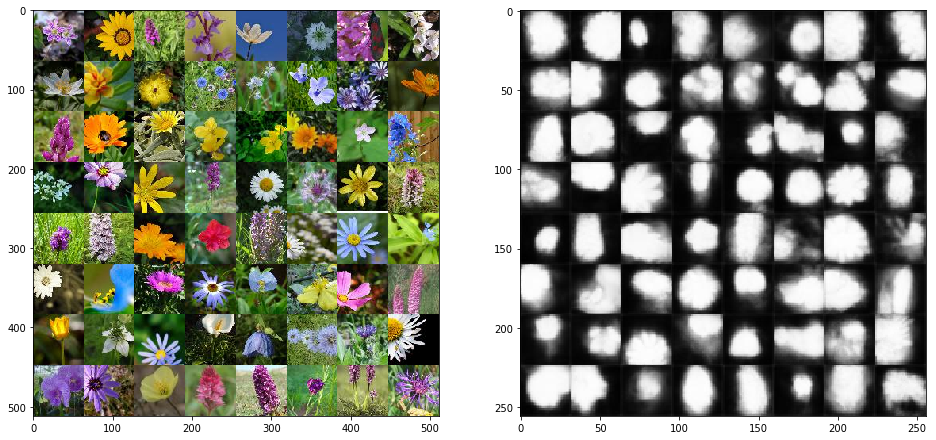

In [4]:
# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(16,8))
plt.axis("off")
plt.title("Training Images")
plt.subplot(1,2,1)
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=0, normalize=True).cpu(),(1,2,0)))
plt.subplot(1,2,2)
plt.imshow(np.transpose(vutils.make_grid(real_batch[1][-1].to(device)[:64], padding=0, normalize=True).cpu(),(1,2,0)))
plt.show()

In [5]:
# Create the Generator
netG = Generator(ngpu, ngf, nz, nc, mask_sizes=[2,4,8,16,32]).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)
print("netG parameters:", [p.numel() for p in netG.parameters() if p.requires_grad])

Generator(
  (layer1): Sequential(
    (0): ConvTranspose2d(33, 1024, kernel_size=(4, 4), stride=(2, 2), bias=False)
    (1): ReflectionPad2d((-1, -1, -1, -1))
    (2): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): ReLU(inplace)
  )
  (layer2): Sequential(
    (0): ConvTranspose2d(1025, 512, kernel_size=(4, 4), stride=(2, 2), bias=False)
    (1): ReflectionPad2d((-1, -1, -1, -1))
    (2): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): ReLU(inplace)
  )
  (layer3): Sequential(
    (0): ConvTranspose2d(513, 256, kernel_size=(4, 4), stride=(2, 2), bias=False)
    (1): ReflectionPad2d((-1, -1, -1, -1))
    (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): ReLU(inplace)
  )
  (layer4): Sequential(
    (0): ConvTranspose2d(257, 128, kernel_size=(4, 4), stride=(2, 2), bias=False)
    (1): ReflectionPad2d((-1, -1, -1, -1))
    (2): BatchNorm2d(128, eps=1e-05, mom

In [6]:
# Create the Discriminator
netD = Discriminator(ngpu, ndf, nc, mask_sizes=[4,8,16]).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)
print("netD parameters", [p.numel() for p in netD.parameters() if p.requires_grad])

Discriminator(
  (layer1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
  )
  (layer2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace)
  )
  (layer3): Sequential(
    (0): Conv2d(129, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace)
  )
  (layer4): Sequential(
    (0): Conv2d(257, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace)
  )
  (layer5): Sequential(
    (0): Conv2d(513, 1, kernel_size

torch.Size([64, 1, 1, 1])

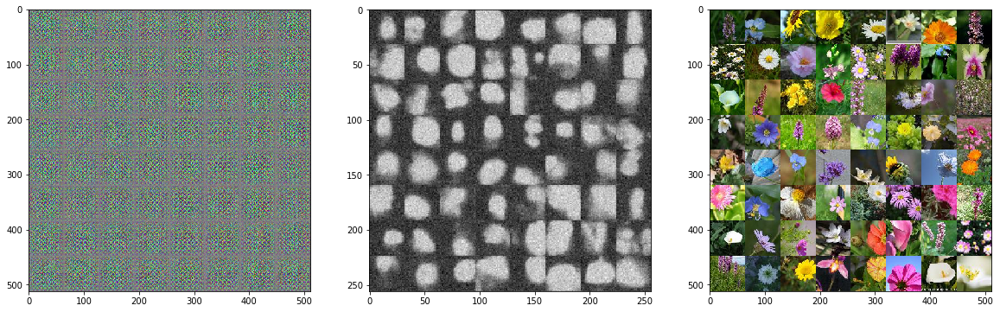

In [7]:
# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 2, 2, device=device)
fixed_mask = [torch.randn(64, 1, size, size, device=device, dtype=torch.float32) * 0.2 for size in mask_sizes]
fixed_image = torch.zeros(64, 3, 64, 64, device=device)
for i in range(64):
    n = np.random.randint(len(realdata))
    for k, mask in enumerate(fixed_mask):
        mask[i,:,:,:] += realdata[n][1][k].to(device)
    fixed_image[i,:,:,:] = realdata[n][0]

fake_image = netG(fixed_noise, fixed_mask)
output = netD(fake_image, fixed_mask)
#show_image_n_mask((fake_image[0].detach().cpu(), mask[0].detach().cpu())), output.cpu()
plt.figure(figsize=(20,6))
plt.subplot(1,3,1)
plt.imshow(np.transpose(vutils.make_grid(fake_image.detach(), padding=0, normalize=True).cpu(),(1,2,0)))
plt.subplot(1,3,2)
plt.imshow(np.transpose(vutils.make_grid(fixed_mask[-1].detach(), padding=0, normalize=True).cpu(),(1,2,0)))
plt.subplot(1,3,3)
plt.imshow(np.transpose(vutils.make_grid(fixed_image.detach(), padding=0, normalize=True).cpu(),(1,2,0)))
output.size()

In [8]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Establish convention for real and fake labels during training
real_label = 1
real_smooth = 0.9
fake_label = 0

# Setup Adam optimizers for both G and D
lr = 0.0002
beta1 = 0.5
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [9]:
# Training Loop
!mkdir model_checkpoints
!mkdir sample_images
!mkdir sample_images/gan_z22_mask

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0
num_epochs = 250
start_epoch= 1
n_update_G = 2

print("Starting Training Loop...")
# For each epoch
for epoch in range(start_epoch, start_epoch+num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_image = noise_input(data[0], noise_level=0.2*np.exp(-epoch*0.01), device=device, clip=False)
        real_mask = [noise_input(x, noise_level=mask_noise, device=device) for x in data[1]]
        b_size = real_image.size(0)
        label = torch.full((b_size,), real_smooth, device=device)
        # Forward pass real batch through D
        output = netD(real_image, real_mask).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 2, 2, device=device)
        mask = sample_mask(b_size, sizes=mask_sizes, realdata=realdata, noise_level=mask_noise, device=device)
        # Generate fake image batch with G
        fake_image = netG(noise, mask)
        fake_image = noise_input(fake_image, noise_level=0.2*np.exp(-epoch*0.01), device=device, clip=False)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake_image.detach(), mask).view(-1)
        #print("output1",output[:5])
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()
        
        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake_image, mask).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()        
               
        # Output training stats
        if i % 256 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f (%.4f / %.4f)   Loss_G: %.4f\tD(x): %.4f   D(G(z)): %.4f / %.4f'
                  % (epoch-start_epoch, num_epochs, i, len(dataloader),
                     errD.item(), errD_real.item(), errD_fake.item(), errG.item(), D_x, D_G_z1, D_G_z2))
            Dgradnorm_first = list(netD.parameters())[0].grad.norm()
            Ggradnorm_first = list(netG.parameters())[0].grad.norm()
            Ggradnorm_last = list(netG.parameters())[-1].grad.norm()
            print("Ggradnorm first: %.4f\t Ggradnormlast: %.4f\t Dgradnormlast: %.4f"%(Ggradnorm_first, Ggradnorm_last, Dgradnorm_first))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        iters += 1

    # Check how the generator is doing by saving G's output on fixed_noise
    with torch.no_grad():
        fake_image = netG(fixed_noise, fixed_mask).detach().cpu()
        image_tensor = vutils.make_grid(fake_image, padding=2, normalize=True)
        img_list.append(image_tensor)
        filepath = 'sample_images/gan_z22_mask/ep'+str(epoch)+'.jpg'
        io.imsave(filepath, image_tensor.numpy().transpose(1,2,0))
        
    if epoch%20==0:
        checkpoint_path = "model_checkpoints/GAN_z22_mask_ep"+str(epoch)
        print('save model to %s'%checkpoint_path)
        torch.save({
            'netG_state_dict': netG.state_dict(),
            'netD_state_dict': netD.state_dict(),
            'optimizerG_state_dict': optimizerG.state_dict(),
            'optimizerD_state_dict': optimizerD.state_dict(),
            }, checkpoint_path)
        
    if epoch%decay_every==0:
        adjust_learning_rate(optimizerD, lr_decay)
        adjust_learning_rate(optimizerG, lr_decay)  
        
print('Done')

mkdir: cannot create directory ‘model_checkpoints’: File exists
mkdir: cannot create directory ‘sample_images’: File exists
Starting Training Loop...
[0/250][0/423]	Loss_D: 1.7039 (0.7148 / 0.9891)   Loss_G: 5.6296	D(x): 0.5647   D(G(z)): 0.5746 / 0.0024
Ggradnorm first: 11.2900	 Ggradnormlast: 15.6927	 Dgradnormlast: 10.3616
[0/250][256/423]	Loss_D: 0.9771 (0.6501 / 0.3269)   Loss_G: 1.7136	D(x): 0.5860   D(G(z)): 0.2628 / 0.1814
Ggradnorm first: 2.2610	 Ggradnormlast: 7.7606	 Dgradnormlast: 15.1893


/usr/local/lib/python3.5/dist-packages/skimage/util/dtype.py:141: UserWarning: Possible precision loss when converting from float32 to uint8
  .format(dtypeobj_in, dtypeobj_out))


[1/250][0/423]	Loss_D: 0.9640 (0.3651 / 0.5990)   Loss_G: 3.5069	D(x): 0.8641   D(G(z)): 0.4048 / 0.0393
Ggradnorm first: 3.1720	 Ggradnormlast: 7.2479	 Dgradnormlast: 10.7969
[1/250][256/423]	Loss_D: 1.2299 (1.1380 / 0.0919)   Loss_G: 1.6265	D(x): 0.3554   D(G(z)): 0.0835 / 0.2090
Ggradnorm first: 3.0060	 Ggradnormlast: 6.2056	 Dgradnormlast: 27.7983
[2/250][0/423]	Loss_D: 1.2824 (0.4329 / 0.8495)   Loss_G: 3.5869	D(x): 0.8630   D(G(z)): 0.5014 / 0.0310
Ggradnorm first: 2.8539	 Ggradnormlast: 7.3539	 Dgradnormlast: 7.6316
[2/250][256/423]	Loss_D: 0.8146 (0.6297 / 0.1850)   Loss_G: 1.5335	D(x): 0.5931   D(G(z)): 0.1635 / 0.2158
Ggradnorm first: 2.1919	 Ggradnormlast: 3.2995	 Dgradnormlast: 20.0832
[3/250][0/423]	Loss_D: 1.2531 (0.5277 / 0.7254)   Loss_G: 2.4793	D(x): 0.6829   D(G(z)): 0.4836 / 0.0899
Ggradnorm first: 2.8838	 Ggradnormlast: 4.9462	 Dgradnormlast: 12.6001
[3/250][256/423]	Loss_D: 1.1096 (0.4342 / 0.6755)   Loss_G: 1.9711	D(x): 0.7489   D(G(z)): 0.4506 / 0.1376
Ggradnorm 

[24/250][0/423]	Loss_D: 2.7300 (0.4418 / 2.2882)   Loss_G: 5.1818	D(x): 0.9731   D(G(z)): 0.8434 / 0.0050
Ggradnorm first: 4.8195	 Ggradnormlast: 6.1090	 Dgradnormlast: 46.4352
[24/250][256/423]	Loss_D: 0.8974 (0.8467 / 0.0507)   Loss_G: 1.5621	D(x): 0.4605   D(G(z)): 0.0472 / 0.2327
Ggradnorm first: 3.3866	 Ggradnormlast: 2.9160	 Dgradnormlast: 37.5539
[25/250][0/423]	Loss_D: 0.8954 (0.3766 / 0.5188)   Loss_G: 4.9433	D(x): 0.9543   D(G(z)): 0.3755 / 0.0057
Ggradnorm first: 5.3657	 Ggradnormlast: 5.3732	 Dgradnormlast: 32.9982
[25/250][256/423]	Loss_D: 0.6134 (0.3614 / 0.2520)   Loss_G: 3.7200	D(x): 0.9321   D(G(z)): 0.2144 / 0.0192
Ggradnorm first: 4.9727	 Ggradnormlast: 3.2772	 Dgradnormlast: 23.8652
[26/250][0/423]	Loss_D: 1.2776 (0.3767 / 0.9009)   Loss_G: 4.8993	D(x): 0.8684   D(G(z)): 0.5038 / 0.0065
Ggradnorm first: 5.1674	 Ggradnormlast: 6.9103	 Dgradnormlast: 28.8622
[26/250][256/423]	Loss_D: 0.4806 (0.4403 / 0.0403)   Loss_G: 2.5486	D(x): 0.7280   D(G(z)): 0.0392 / 0.0745
Ggr

[47/250][0/423]	Loss_D: 0.4438 (0.3785 / 0.0653)   Loss_G: 3.4915	D(x): 0.8491   D(G(z)): 0.0596 / 0.0315
Ggradnorm first: 6.2201	 Ggradnormlast: 8.0816	 Dgradnormlast: 55.5719
[47/250][256/423]	Loss_D: 0.4981 (0.3681 / 0.1300)   Loss_G: 4.5272	D(x): 0.9314   D(G(z)): 0.1141 / 0.0087
Ggradnorm first: 7.5262	 Ggradnormlast: 8.8875	 Dgradnormlast: 38.6758
[48/250][0/423]	Loss_D: 0.5947 (0.5740 / 0.0207)   Loss_G: 2.7333	D(x): 0.6346   D(G(z)): 0.0201 / 0.0712
Ggradnorm first: 6.8448	 Ggradnormlast: 27.3974	 Dgradnormlast: 72.8921
[48/250][256/423]	Loss_D: 0.4248 (0.3824 / 0.0423)   Loss_G: 3.8170	D(x): 0.8283   D(G(z)): 0.0409 / 0.0203
Ggradnorm first: 7.1645	 Ggradnormlast: 7.0224	 Dgradnormlast: 49.6985
[49/250][0/423]	Loss_D: 0.5669 (0.4265 / 0.1404)   Loss_G: 4.4447	D(x): 0.9747   D(G(z)): 0.1220 / 0.0099
Ggradnorm first: 6.3152	 Ggradnormlast: 8.4168	 Dgradnormlast: 34.8748
[49/250][256/423]	Loss_D: 0.4016 (0.3767 / 0.0249)   Loss_G: 4.1872	D(x): 0.8379   D(G(z)): 0.0241 / 0.0131
Gg

[70/250][0/423]	Loss_D: 0.4844 (0.4227 / 0.0616)   Loss_G: 3.6569	D(x): 0.9768   D(G(z)): 0.0585 / 0.0228
Ggradnorm first: 6.4695	 Ggradnormlast: 22.7246	 Dgradnormlast: 32.6957
[70/250][256/423]	Loss_D: 0.4173 (0.3919 / 0.0253)   Loss_G: 3.1899	D(x): 0.7926   D(G(z)): 0.0248 / 0.0367
Ggradnorm first: 6.8852	 Ggradnormlast: 7.9424	 Dgradnormlast: 37.5116
[71/250][0/423]	Loss_D: 0.4400 (0.3640 / 0.0760)   Loss_G: 3.6513	D(x): 0.9139   D(G(z)): 0.0703 / 0.0213
Ggradnorm first: 7.2926	 Ggradnormlast: 12.7563	 Dgradnormlast: 44.0242
[71/250][256/423]	Loss_D: 0.4356 (0.4055 / 0.0300)   Loss_G: 4.3040	D(x): 0.9706   D(G(z)): 0.0290 / 0.0136
Ggradnorm first: 8.1500	 Ggradnormlast: 13.6810	 Dgradnormlast: 37.6853
[72/250][0/423]	Loss_D: 0.5308 (0.5261 / 0.0047)   Loss_G: 3.3865	D(x): 0.6565   D(G(z)): 0.0047 / 0.0356
Ggradnorm first: 7.4635	 Ggradnormlast: 15.1586	 Dgradnormlast: 50.6875
[72/250][256/423]	Loss_D: 0.4037 (0.3996 / 0.0041)   Loss_G: 4.6714	D(x): 0.7814   D(G(z)): 0.0041 / 0.0077

[93/250][0/423]	Loss_D: 0.3836 (0.3592 / 0.0244)   Loss_G: 3.7082	D(x): 0.9295   D(G(z)): 0.0240 / 0.0210
Ggradnorm first: 11.9834	 Ggradnormlast: 28.8555	 Dgradnormlast: 60.6863
[93/250][256/423]	Loss_D: 0.3939 (0.3610 / 0.0329)   Loss_G: 4.7321	D(x): 0.9206   D(G(z)): 0.0319 / 0.0071
Ggradnorm first: 7.8430	 Ggradnormlast: 14.1199	 Dgradnormlast: 39.9161
[94/250][0/423]	Loss_D: 0.3921 (0.3812 / 0.0109)   Loss_G: 4.3064	D(x): 0.8153   D(G(z)): 0.0108 / 0.0119
Ggradnorm first: 8.2118	 Ggradnormlast: 12.0310	 Dgradnormlast: 40.7740
[94/250][256/423]	Loss_D: 0.3785 (0.3525 / 0.0260)   Loss_G: 3.6348	D(x): 0.8551   D(G(z)): 0.0252 / 0.0256
Ggradnorm first: 8.1751	 Ggradnormlast: 16.7988	 Dgradnormlast: 37.9726
[95/250][0/423]	Loss_D: 0.3813 (0.3605 / 0.0208)   Loss_G: 4.3193	D(x): 0.9234   D(G(z)): 0.0205 / 0.0115
Ggradnorm first: 7.7153	 Ggradnormlast: 22.3242	 Dgradnormlast: 39.6383
[95/250][256/423]	Loss_D: 0.6074 (0.4739 / 0.1336)   Loss_G: 3.6100	D(x): 0.9843   D(G(z)): 0.1176 / 0.02

[116/250][0/423]	Loss_D: 0.4164 (0.3830 / 0.0334)   Loss_G: 4.3555	D(x): 0.9642   D(G(z)): 0.0324 / 0.0110
Ggradnorm first: 8.7532	 Ggradnormlast: 14.3797	 Dgradnormlast: 34.9967
[116/250][256/423]	Loss_D: 0.3737 (0.3637 / 0.0100)   Loss_G: 4.0785	D(x): 0.8254   D(G(z)): 0.0099 / 0.0162
Ggradnorm first: 8.5207	 Ggradnormlast: 15.5759	 Dgradnormlast: 45.5616
[117/250][0/423]	Loss_D: 1.1198 (0.5770 / 0.5428)   Loss_G: 6.2850	D(x): 0.9950   D(G(z)): 0.3701 / 0.0012
Ggradnorm first: 8.5239	 Ggradnormlast: 27.3488	 Dgradnormlast: 45.0267
[117/250][256/423]	Loss_D: 0.5427 (0.5397 / 0.0030)   Loss_G: 3.2957	D(x): 0.6357   D(G(z)): 0.0030 / 0.0346
Ggradnorm first: 8.6806	 Ggradnormlast: 17.9531	 Dgradnormlast: 53.9146
[118/250][0/423]	Loss_D: 0.3690 (0.3518 / 0.0172)   Loss_G: 4.3715	D(x): 0.8728   D(G(z)): 0.0168 / 0.0134
Ggradnorm first: 7.8964	 Ggradnormlast: 18.1478	 Dgradnormlast: 39.1718
[118/250][256/423]	Loss_D: 0.5034 (0.5021 / 0.0013)   Loss_G: 4.4987	D(x): 0.6691   D(G(z)): 0.0013 /

[139/250][0/423]	Loss_D: 0.3885 (0.3810 / 0.0075)   Loss_G: 3.8074	D(x): 0.7986   D(G(z)): 0.0074 / 0.0212
Ggradnorm first: 7.3388	 Ggradnormlast: 20.8601	 Dgradnormlast: 49.1424
[139/250][256/423]	Loss_D: 0.3490 (0.3380 / 0.0111)   Loss_G: 4.7627	D(x): 0.9053   D(G(z)): 0.0110 / 0.0070
Ggradnorm first: 7.9890	 Ggradnormlast: 24.5193	 Dgradnormlast: 40.8642
save model to model_checkpoints/GAN_z22_mask_ep140
[140/250][0/423]	Loss_D: 0.3554 (0.3459 / 0.0095)   Loss_G: 4.8024	D(x): 0.9308   D(G(z)): 0.0094 / 0.0073
Ggradnorm first: 8.5060	 Ggradnormlast: 31.3150	 Dgradnormlast: 44.6639
[140/250][256/423]	Loss_D: 0.3761 (0.3649 / 0.0112)   Loss_G: 5.2829	D(x): 0.9576   D(G(z)): 0.0111 / 0.0037
Ggradnorm first: 7.6272	 Ggradnormlast: 27.6419	 Dgradnormlast: 42.8382
[141/250][0/423]	Loss_D: 0.3565 (0.3444 / 0.0120)   Loss_G: 4.8442	D(x): 0.9250   D(G(z)): 0.0119 / 0.0065
Ggradnorm first: 8.1235	 Ggradnormlast: 46.7311	 Dgradnormlast: 51.8188
[141/250][256/423]	Loss_D: 0.4275 (0.4249 / 0.0026

[161/250][256/423]	Loss_D: 0.3546 (0.3470 / 0.0076)   Loss_G: 4.2478	D(x): 0.8485   D(G(z)): 0.0076 / 0.0134
Ggradnorm first: 9.1292	 Ggradnormlast: 31.2885	 Dgradnormlast: 52.7923
[162/250][0/423]	Loss_D: 0.3563 (0.3369 / 0.0194)   Loss_G: 4.2498	D(x): 0.8941   D(G(z)): 0.0191 / 0.0118
Ggradnorm first: 8.6035	 Ggradnormlast: 23.5527	 Dgradnormlast: 45.1373
[162/250][256/423]	Loss_D: 0.3471 (0.3408 / 0.0063)   Loss_G: 5.1028	D(x): 0.8935   D(G(z)): 0.0063 / 0.0047
Ggradnorm first: 9.6116	 Ggradnormlast: 30.8117	 Dgradnormlast: 53.8998
[163/250][0/423]	Loss_D: 0.3416 (0.3396 / 0.0020)   Loss_G: 5.8444	D(x): 0.8775   D(G(z)): 0.0020 / 0.0022
Ggradnorm first: 8.9321	 Ggradnormlast: 22.2224	 Dgradnormlast: 49.2313
[163/250][256/423]	Loss_D: 0.3434 (0.3348 / 0.0086)   Loss_G: 4.8178	D(x): 0.9164   D(G(z)): 0.0085 / 0.0060
Ggradnorm first: 9.1505	 Ggradnormlast: 28.7581	 Dgradnormlast: 49.4891
[164/250][0/423]	Loss_D: 0.3645 (0.3583 / 0.0063)   Loss_G: 5.4887	D(x): 0.9491   D(G(z)): 0.0063 /

[184/250][256/423]	Loss_D: 0.3470 (0.3425 / 0.0046)   Loss_G: 5.0399	D(x): 0.8582   D(G(z)): 0.0046 / 0.0048
Ggradnorm first: 8.6315	 Ggradnormlast: 41.3076	 Dgradnormlast: 49.1123
[185/250][0/423]	Loss_D: 0.4002 (0.3863 / 0.0138)   Loss_G: 4.6817	D(x): 0.9694   D(G(z)): 0.0137 / 0.0072
Ggradnorm first: 8.3170	 Ggradnormlast: 54.4118	 Dgradnormlast: 40.6187
[185/250][256/423]	Loss_D: 0.3382 (0.3349 / 0.0033)   Loss_G: 5.2744	D(x): 0.8825   D(G(z)): 0.0033 / 0.0038
Ggradnorm first: 8.3610	 Ggradnormlast: 39.5799	 Dgradnormlast: 56.1695
[186/250][0/423]	Loss_D: 0.3707 (0.3603 / 0.0103)   Loss_G: 5.1052	D(x): 0.9539   D(G(z)): 0.0102 / 0.0045
Ggradnorm first: 8.6670	 Ggradnormlast: 35.0563	 Dgradnormlast: 46.8510
[186/250][256/423]	Loss_D: 0.3470 (0.3372 / 0.0098)   Loss_G: 4.7027	D(x): 0.9130   D(G(z)): 0.0097 / 0.0074
Ggradnorm first: 8.9433	 Ggradnormlast: 65.8756	 Dgradnormlast: 50.9687
[187/250][0/423]	Loss_D: 0.3384 (0.3330 / 0.0053)   Loss_G: 5.1219	D(x): 0.9074   D(G(z)): 0.0053 /

[207/250][256/423]	Loss_D: 0.3617 (0.3488 / 0.0129)   Loss_G: 4.4526	D(x): 0.9399   D(G(z)): 0.0127 / 0.0094
Ggradnorm first: 8.5026	 Ggradnormlast: 35.7868	 Dgradnormlast: 62.6035
[208/250][0/423]	Loss_D: 0.3418 (0.3378 / 0.0041)   Loss_G: 4.9871	D(x): 0.8678   D(G(z)): 0.0040 / 0.0056
Ggradnorm first: 8.1770	 Ggradnormlast: 75.3348	 Dgradnormlast: 43.0086
[208/250][256/423]	Loss_D: 0.3610 (0.3509 / 0.0100)   Loss_G: 4.0326	D(x): 0.8360   D(G(z)): 0.0099 / 0.0149
Ggradnorm first: 7.6661	 Ggradnormlast: 45.0693	 Dgradnormlast: 51.7429
[209/250][0/423]	Loss_D: 0.3468 (0.3379 / 0.0089)   Loss_G: 4.8577	D(x): 0.9330   D(G(z)): 0.0088 / 0.0062
Ggradnorm first: 8.4020	 Ggradnormlast: 81.6493	 Dgradnormlast: 37.1070
[209/250][256/423]	Loss_D: 0.3879 (0.3780 / 0.0100)   Loss_G: 4.9670	D(x): 0.9624   D(G(z)): 0.0099 / 0.0052
Ggradnorm first: 7.7636	 Ggradnormlast: 49.4790	 Dgradnormlast: 49.7775
[210/250][0/423]	Loss_D: 0.3539 (0.3453 / 0.0086)   Loss_G: 4.3959	D(x): 0.8473   D(G(z)): 0.0086 /

[230/250][256/423]	Loss_D: 0.3380 (0.3355 / 0.0025)   Loss_G: 5.9740	D(x): 0.8856   D(G(z)): 0.0025 / 0.0019
Ggradnorm first: 8.8055	 Ggradnormlast: 34.9164	 Dgradnormlast: 42.3909
[231/250][0/423]	Loss_D: 0.3427 (0.3373 / 0.0054)   Loss_G: 5.2880	D(x): 0.9209   D(G(z)): 0.0054 / 0.0040
Ggradnorm first: 7.9898	 Ggradnormlast: 56.5413	 Dgradnormlast: 49.3423
[231/250][256/423]	Loss_D: 0.3430 (0.3399 / 0.0030)   Loss_G: 5.4566	D(x): 0.8582   D(G(z)): 0.0030 / 0.0033
Ggradnorm first: 7.9128	 Ggradnormlast: 50.6556	 Dgradnormlast: 61.6181
[232/250][0/423]	Loss_D: 0.3456 (0.3408 / 0.0049)   Loss_G: 4.7194	D(x): 0.8608   D(G(z)): 0.0048 / 0.0071
Ggradnorm first: 8.1026	 Ggradnormlast: 50.4257	 Dgradnormlast: 47.7359
[232/250][256/423]	Loss_D: 0.3490 (0.3440 / 0.0050)   Loss_G: 4.7766	D(x): 0.8453   D(G(z)): 0.0050 / 0.0065
Ggradnorm first: 8.7797	 Ggradnormlast: 27.5971	 Dgradnormlast: 77.0195
[233/250][0/423]	Loss_D: 0.6037 (0.4883 / 0.1154)   Loss_G: 3.4293	D(x): 0.9906   D(G(z)): 0.1059 /

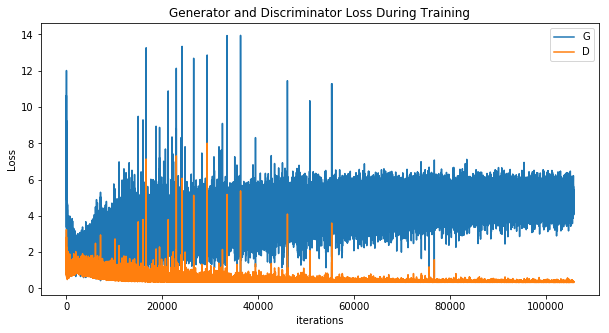

In [10]:
# plot losses during training
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21350431 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


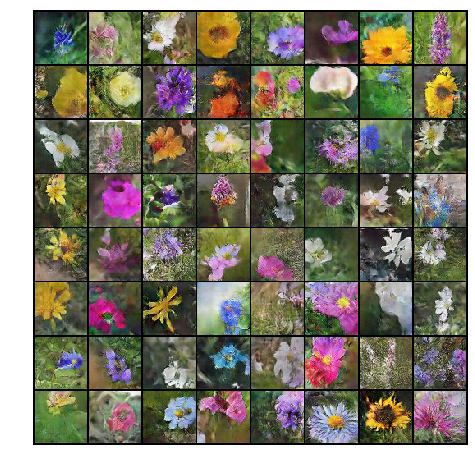

In [11]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
ani.save("gan_mask.gif")
HTML(ani.to_jshtml())

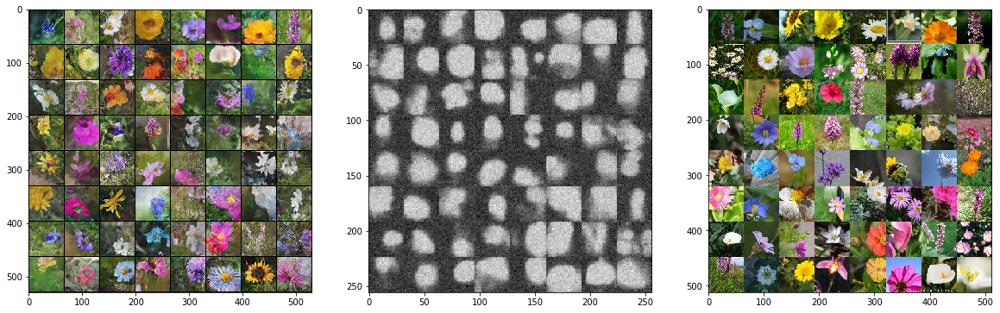

In [12]:
plt.figure(figsize=(20,8))
plt.subplot(1,3,1) # generated images
plt.imshow(np.transpose(vutils.make_grid(img_list[-1], padding=0, normalize=True).cpu(),(1,2,0)))
plt.subplot(1,3,2) # corresponding masks
plt.imshow(np.transpose(vutils.make_grid(fixed_mask[-1].detach(), padding=0, normalize=True).cpu(),(1,2,0)))
plt.subplot(1,3,3) # the original images
plt.imshow(np.transpose(vutils.make_grid(fixed_image.detach(), padding=0, normalize=True).cpu(),(1,2,0)))

In [13]:
# save model
torch.save({
            'netG_state_dict': netG.state_dict(),
            'netD_state_dict': netD.state_dict(),
            'optimizerG_state_dict': optimizerG.state_dict(),
            'optimizerD_state_dict': optimizerD.state_dict(),
            }, "model_checkpoints/GAN_z22_mask")